In [13]:
#| hide
# from rsna_ab_trauma.core import *
from fastcore.all import Path
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

EXAMPLE_PATH = Path('../small_data/ct_scan_example')

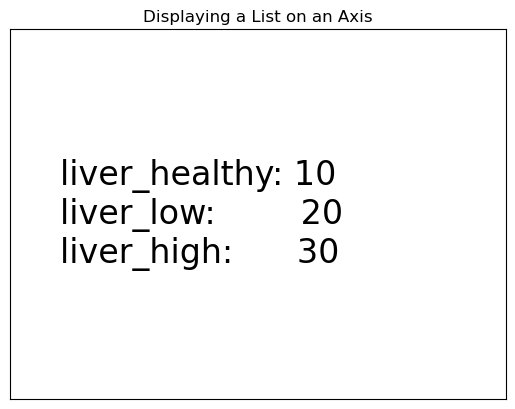

In [133]:
import matplotlib.pyplot as plt

# Sample list of numbers

# Create a figure and axis
fig, ax = plt.subplots()


# Show the plot
plt.show()

In [96]:
type([3, 3]) == list

True

In [101]:
#| hide 
def animate_images(images: list, figsize=(6, 6), cmap=None):
    """
    Run HTML({returned_object}) to see animation
    Original animation code from https://www.kaggle.com/code/franklinshih0617/rsna-abdominal-trauma-detect-eda-animation
    """
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(images[len(images) // 2], cmap=cmap) 
    def update(i): 
        im.set_array(images[i])
    ani = animation.FuncAnimation(fig, update, frames=range(len(images)), repeat=True)
    return ani.to_jshtml()

In [ ]:
pred_masks

In [ ]:
raw_imgs = np.load(EXAMPLE_PATH/'raw_imgs.npy', )
seg_inp = np.load(EXAMPLE_PATH/'seg_inp.npy')
pred_masks = np.load(EXAMPLE_PATH/'pred_masks.npy')
cls_inp = np.load(EXAMPLE_PATH/'cls_inp.npy')

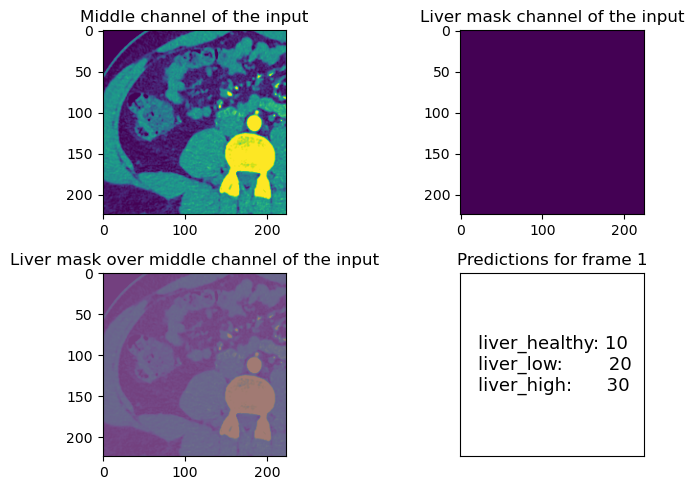

In [146]:
images = list(cls_inp[:, 2, :, :])
liver_mask = list(cls_inp[:, 5, :, :])
figsize=(8, 5)
cmap=None
fig, ax = plt.subplots(2, 2, figsize=figsize)
ax = ax.flatten()
im = ax[0].imshow(images[len(images) // 2], cmap=cmap) 
ax[0].set_title('Middle channel of the input')

im2 = ax[1].imshow(liver_mask[len(images) // 2], cmap=cmap) 
ax[1].set_title('Liver mask channel of the input')

im3 = ax[2].imshow(images[len(images) // 2], cmap=cmap, alpha=.5) 
im4 = ax[2].imshow(liver_mask[len(images) // 2], cmap=cmap, alpha=.5) 
ax[2].set_title('Liver mask over middle channel of the input')


preds = [10, 20, 30]
text = f'liver_healthy: {preds[0]}\n\
liver_low:        {preds[1]}\n\
liver_high:      {preds[2]}'
ax[3].text(0.1, 0.5, text, fontsize=13, va='center')
ax[3].set_xticks([])
ax[3].set_yticks([])
ax[3].set_title('Predictions for frame 0')
ax[3].set_aspect('equal')
plt.tight_layout()

def update(i): 
    ax[3].set_title(f'Predictions for frame {i + 1}')
    im.set_array(images[i])
    im2.set_array(liver_mask[i])
    im3.set_array(images[i])
    im4.set_array(liver_mask[i])
ani = animation.FuncAnimation(fig, update, frames=range(len(images)), repeat=True)
HTML(ani.to_jshtml())

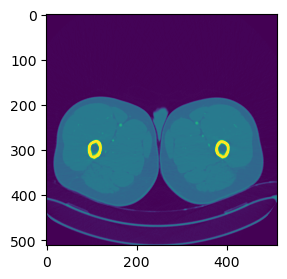

In [151]:
HTML(animate_images(raw_imgs, figsize=(3, 3)))

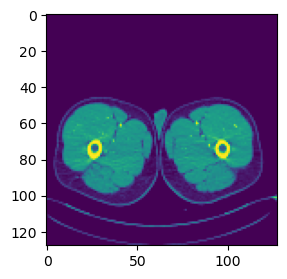

In [152]:
x = (seg_inp * 4000).astype(int)
x = list(np.transpose(x, (2, 0, 1)))
HTML(animate_images(list(x), figsize=(3, 3)))


In [66]:
x[0].shape

(128, 128)

In [155]:
pred_masks.shape

(128, 128, 128)

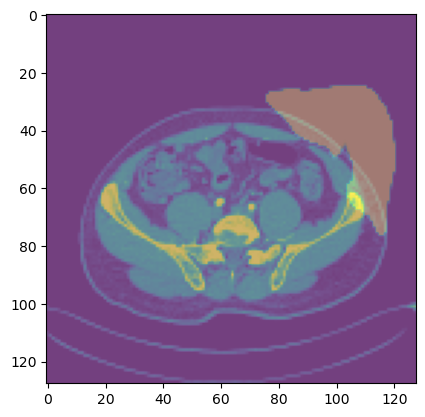

In [153]:
y = (pred_masks * 4000).astype(int)
fig, ax = plt.subplots()
ax.imshow(y[60], alpha=.5)
ax.imshow(x[60], alpha=.5)

plt.show()

1.0

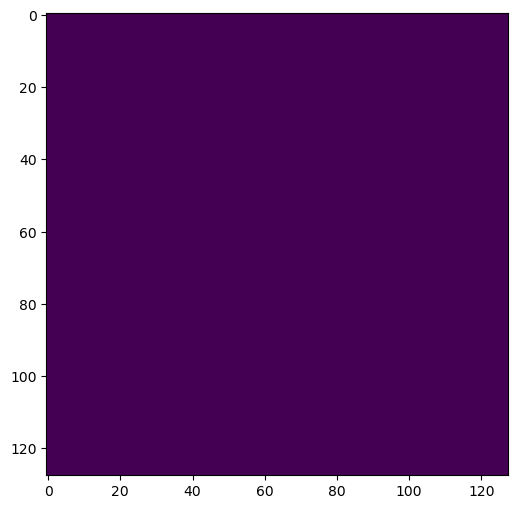

In [53]:
x = (pred_masks * 4000).astype(int)
x = list(x)
# x = list(np.transpose(x, (2, 0, 1)))
HTML(animate_images(list(x)))

In [86]:
cls_inp[:, 5, :, :].max()

1.0

In [148]:
raw_imgs.shape

(316, 512, 512)

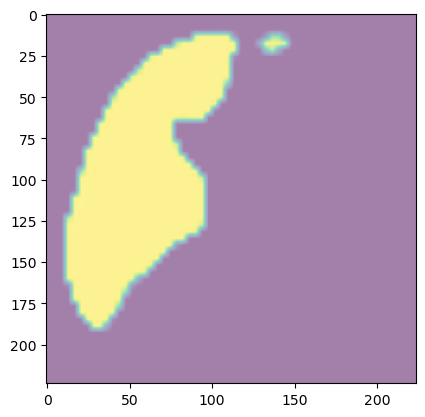

In [91]:
x = list(cls_inp[:, 5, :, :])
fig, ax = plt.subplots()
ax.imshow(x[5], alpha=.5)


# Predicting Organ Injuries from Blunt Force Trauma using CT Scans and Machine Learning. 

## Problem: we need faster diagnoses of organ injuries
A recent study has estimated the incident rate for trauma patients with solid organ injuries at 5.4 per 100,000. Of these patients, 12.5% die within 30 days (Larsen, J. W., et al., 2022). It is difficult to determine if a patient with abdominal trauma has solid organ injuries that need immediate surgery. "Computed tomography (CT) has become an indispensable tool in evaluating patients with suspected abdominal injuries due to its ability to provide detailed cross-sectional images of the abdomen" (Errol Colak, et al., 2023). However, the process is time consuming, and requires experts to analyze the scans. 


## Deliverables
 * A model that takes a CT scan and produces probabilities for the injury status of a patients liver
 * A model that can segment out the liver from a CT scan
 * A report and slide deck outlining process, outcomes, and recommendations
 
## Stakeholders
Doctor and radiologists who use abdominal CT scans of patients and need to diagnose the injury status of their liver, especially when deciding if surgery is needed.


## Proposed solution
A two stage deep learning model that takes a CT scan as an input, and predicts the injury status of an organ. The predictions will be probabilities for each of three labels: no injury, mild injury, and severe injury. A severe injury is one which requires immediate surgery (Errol Colak, et al., 2023). The first stage of the model predicts the segmentation mask of the organ. The second stage of the model predicts the injury status of the organ. 

In this study I will focus on the liver, since it is the most common injury found in abdominal trauma patients (Larsen, J. W., et al., 2022). 

The baseline framework for my solution is based on work done on a similar problem, predicting spinal fractures from CT scans. This work was done by Qishen Ha, with write up an links to code at [https://www.kaggle.com/competitions/rsna-2022-cervical-spine-fracture-detection/discussion/362607](https://www.kaggle.com/competitions/rsna-2022-cervical-spine-fracture-detection/discussion/362607). This baseline is applied to all organs (liver, kidney, spleen), and achieves 79th place out of 1126 teams in the Kaggle competition which is the source of data used for this project (Errol Colak, et al., 2023). The write up for my solution to the competition can be found at [https://www.kaggle.com/competitions/rsna-2023-abdominal-trauma-detection/discussion/450279](https://www.kaggle.com/competitions/rsna-2023-abdominal-trauma-detection/discussion/450279).

### Recommendations 
1) Use the predictions to triage patients. If their are many CT scans, but few experts to analyze those scans, we could use this model to find the scans that require the most urgent need of analysis. 

2) Use bounding box predictions to expedite analysis. We could automatically create visual reports, which contain only the liver, leading to analysis that is faster and easier. 


## Methodology overview 

### Model description

 * **Model inputs**: For each patient, the model needs a series of dicom files created from a CT scan.

 * **Model outputs**: A probability for each possible ground truth of the patients liver condition. For example, {healthy: .3, mild_injury: .3, severe_injury: .4}.
 
 * Metric: Sample weighted mean of the binary log loss for each class ('liver_healthy', 'liver_low', 'liver_high') with sample weights (1, 2, 4) respectively. 

### Data 
We have de-identified CT scans for 3,147 patients with with injury labels concerning the liver, spleen, kidney, bowels, and extravasation (internal bleeding). 1564 patients have 2 scans and the rest have 1. We have about 200 scans with segmentation masks for the liver, kidney, spleen, and bowels.

The data is curated from 23 research institutions from 14 countries (Errol Colak, et al., 2023). The data is sourced from the kaggle competition "RSNA 2023 Abdominal Trauma Detection"

#### Data files overview 
**train.csv** Target labels for the train set. Note that patients labeled healthy may still have other medical issues, such as cancer or broken bones, that don't happen to be covered by the competition labels.

   - `patient_id` - A unique ID code for each patient.
   - `[bowel/extravasation]_[healthy/injury]` - The two injury types with binary targets.
   - `[kidney/liver/spleen]_[healthy/low/high]` - The three injury types with three target levels.
   - `any_injury` - Whether the patient had any injury at all.
   
**[train/test]_images/[patient_id]/[series_id]/[image_instance_number].dcm** The CT scan data, in DICOM format. Scans from dozens of different CT machines have been reprocessed to use the run length encoded lossless compression format but retain other differences such as the number of bits per pixel, pixel range, and pixel representation. Expect to see roughly 1,100 patients in the test set.

**[train/test]_series_meta.csv** Each patient may have been scanned once or twice. Each scan contains a series of images.

 - `patient_id` - A unique ID code for each patient.
 - `series_id` - A unique ID code for each scan.
 - `aortic_hu` - The volume of the aorta in hounsfield units. This acts as a reliable proxy for when the scan was. For a multiphasic CT scan, the higher value indicates the late arterial phase.
incomplete_organ - True if one or more organs wasn't fully covered by the scan. This label is only provided for the train set.

**segmentations/** Model generated pixel-level annotations of the relevant organs and some major bones for a subset of the scans in the training set. This data is provided in the nifti file format. The filenames are series IDs. You can find a description of the source model (total segmentator) [here](https://pubs.rsna.org/doi/10.1148/ryai.230024) and the data used to train that model [here](https://zenodo.org/records/6802614).

Note that the NIFTI files and DICOM files are not in the same orientation. Use the NIFTI header information along with DICOM metadata to determine the appropriate orientation.

**[train/test]_dicom_tags.parquet** DICOM tags from every image, extracted with Pydicom. Provided for convenience.

#### Unused data that could be useful for improving the model further
**image_level_labels.csv** Train only. Identifies specific images that contain either bowel or extravasation injuries. 

 - `patient_id` - A unique ID code for each patient.
 - `series_id` - A unique ID code for each scan.
 - `instance_number` - The image number within the scan. The lowest instance number for many series is above zero as the original scans were cropped to the abdomen.
 - `injury_name` - The type of injury visible in the frame.

### Exploratory Data Analysis: 
Found that CT scans have between 30 and 500 total dicom files. Each file has an array 512x512. Each array value represents the density of the tissue in Houndsfield units, ranging 0-4000. 

### Preprocessing 
**Preprocessing for segmentation model**
We ensure that the images are ordered by z-coordinate ascending. Then we resize the 3D image to 128x128x128

**Raw input**

## References
<p style="margin-left: 20px; text-indent: -20px;">
Errol Colak, Hui-Ming Lin, Robyn Ball, Melissa Davis, Adam Flanders, Sabeena Jalal, Kirti Magudia, Brett Marinelli, Savvas Nicolaou, Luciano Prevedello, Jeff Rudie, George Shih, Maryam Vazirabad, John Mongan. (2023). RSNA 2023 Abdominal Trauma Detection. Kaggle. https://kaggle.com/competitions/rsna-2023-abdominal-trauma-detection
</p>
<p style="margin-left: 20px; text-indent: -20px;">
Larsen, J. W., Søreide, K., Søreide, J. A., Tjosevik, K., Kvaløy, J. T., & Thorsen, K. (2022). Epidemiology of abdominal trauma: An age- and sex-adjusted incidence analysis with mortality patterns. <em>Injury, 53</em>(10), 3130–3138. https://doi.org/10.1016/j.injury.2022.06.020
</p>




This file will become your README and also the index of your documentation.

## Introduction 

## Install

```sh
pip install rsna_ab_trauma
```

## How to use

Fill me in please! Don't forget code examples:

In [ ]:
1+1

2